# Computer Vision: Image filtering

In this prac you will research, implement and test some image filtering operations. Image filtering by convolution is a fundamental step in many computer vision tasks and you will find it useful to have a firm grasp of how it works. For example, later in the course we will come across Convolutional Neural Networks (CNNs) which are built from convolutional image filters.

The main aims of the prac are:

- to understand the basics of how images are stored and processed in memory;
- to gain exposure to several common image filters, and understand how they work;
- to get practical experience implementing convolutional image filters;
- to test your intuition about image filtering by running some experiments;
- to report your results in a clear and concise manner.

*This assignment relates to the following ACS CBOK areas: abstraction, design, hardware and software, data and information, HCI and programming.*

## General instructions

Follow the instructions in this Python notebook and the accompanying file *a1code.py* to answer each question. It's your responsibility to make sure your answer to each question is clearly labelled and easy to understand. Note that most questions require some combination of Python code, graphical output, and text analysing or describing your results. Although we will check your code as needed, marks will be assigned based on the quality of your write up rather than for code correctness! This is not a programming test - we are more interested in your understanding of the topic.

Only a small amount of code is required to answer each question. We will make extensive use of the Python libraries

- [numpy](numpy.org) for mathematical functions
- [skimage](https://scikit-image.org) for image loading and processing
- [matplotlib](https://matplotlib.org/stable/index.html) for displaying graphical results
- [jupyter](https://jupyter.org) for Jupyter Notebooks

You should get familiar with the documentation for these libraries so that you can use them effectively.

# The Questions

To get started, below is some setup code to import the libraries we need. You should not need to edit it.

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
# Numpy is the main package for scientific computing with Python. 
import numpy as np

#from skimage import io

# Imports all the methods we define in the file a1code.py
from a1code import *

# Matplotlib is a useful plotting library for python 
import matplotlib.pyplot as plt
# This code is to make matplotlib figures appear inline in the
# notebook rather than in a new window.
%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# Some more magic so that the notebook will reload external python modules;
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

## Question 0: Numpy warm up! (5%)

Before starting the assignment, make sure you have a working Python 3 installation, with up to date versions of the libraries mentioned above. If this is all new to you, I'd suggest  downloading an all in one Python installation such as [Anaconda](https://www.anaconda.com/products/individual). Alternatively you can use a Python package manager such as pip or conda, to get the libraries you need. If you're struggling with this please ask a question on the MyUni discussion forum.

For this assignment, you need some familiarity with numpy syntax. The numpy QuickStart should be enough to get you started:

https://numpy.org/doc/stable/user/quickstart.html

Here are a few warm up exercises to make sure you understand the basics. Answer them in the space below. Be sure to print the output of each question so we can see it!

1. Create a 1D numpy array Z with 12 elements. Fill with values 1 to 12.
2. Reshape Z into a 2D numpy array A with 3 rows and 4 columns.
3. Reshape Z into a 2D numpy array B with 4 rows and 3 columns.
4. Calculate the *matrix* product of A and B.
5. Calculate the *element wise* product of $A$ and $B^T$ (B transpose).


In [3]:
print("1: \n")
Z = np.array([1,2,3,4,5,6,7,8,9,10,11,12])
print(Z)
print ("\n")

print("2: \n")
A = Z.reshape(3,4)
print(A)
print ("\n")

print ("3: \n")
B = Z.reshape(4,3)
print(B)
print ("\n")

print ("4: \n")
ABproduct = A@B
print(ABproduct)
print("\n")

print ("5: \n")
elementWise = A * np.transpose(B)
print(elementWise)

1: 

[ 1  2  3  4  5  6  7  8  9 10 11 12]


2: 

[[ 1  2  3  4]
 [ 5  6  7  8]
 [ 9 10 11 12]]


3: 

[[ 1  2  3]
 [ 4  5  6]
 [ 7  8  9]
 [10 11 12]]


4: 

[[ 70  80  90]
 [158 184 210]
 [246 288 330]]


5: 

[[  1   8  21  40]
 [ 10  30  56  88]
 [ 27  60  99 144]]


You need to be comfortable with numpy arrays because that is how we store images. Let's do that next!

## Question 1: Loading and displaying an image (10%)

Below is a function to display an image using the pyplot module in matplotlib. Implement the `load()` and `print_stats()` functions in a1code.py so that the following code loads the mandrill image, displays it and prints its height, width and channel. 

In [4]:
def display(img, caption=''):
    # Show image using pyplot 
    plt.figure()
    plt.imshow(img)
    plt.title(caption)
    plt.axis('on')
    plt.show()

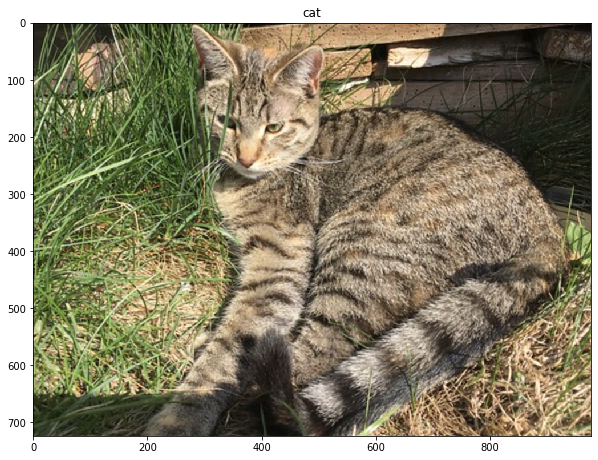

Image Dimension    :  (724, 978, 3)
Image Height       :  724
Image Width        :  978
Number of Channels :  3


In [5]:
image1 = load('/content/cat.jpg')

display(image1, 'cat')

print_stats(image1)

Return to this question after reading through the rest of the assignment. Find 2 more images to use as test cases in this assignment for all the following questions and display them below. Use your print_stats() function to display their height, width and number of channels. Explain *why* you have chosen each image.

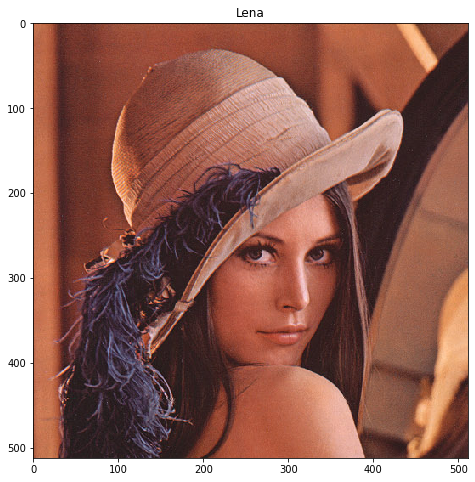

Image Dimension    :  (512, 512, 3)
Image Height       :  512
Image Width        :  512
Number of Channels :  3


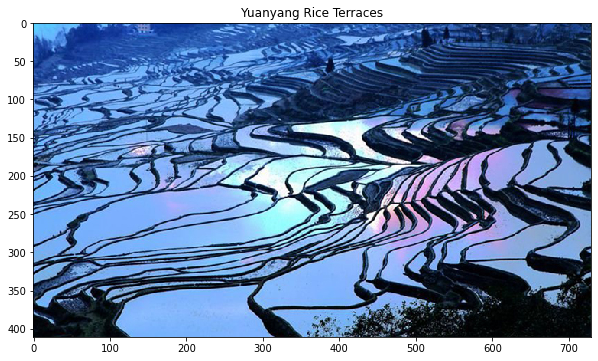

Image Dimension    :  (411, 730, 3)
Image Height       :  411
Image Width        :  730
Number of Channels :  3


In [33]:
### Your code to load and display your images here
test_image_1 = load('/content/test_image1.png')
display(test_image_1, 'Lena')
print_stats(test_image_1)

test_image_2 = load('/content/test_image2.jpg')
display(test_image_2, 'Yuanyang Rice Terraces')
print_stats(test_image_2)

***Your explanation of images here***

The first image is a Swedish woman named Lena and her photo is widely used in testing image-processing research. The reason I've chosen this photo is because I wish to begin my computer vision and image processing journey from this classic and historical image. Moreover, a lot of interesting features can be extracted from this image through Sobel filters and convolution. 

The second image is actually from my hometown and its the Hani ethnic minority's masterpiece of ingenuity. In unique shapes and sizes with thousands of years of history, they form a mosaic of colorful fields — a manmade landscape of breathtaking beauty. Because of this, I think a lot of unique features can be extracted from this image through image processing.

## Question 2: Image processing (20%)

Now that you have an image stored as a numpy array, let's try some operations on it.

1. Implement the `crop()` function in a1code.py. Use array slicing to crop the image.
2. Implement the `resize()` function in a1code.py.
3. Implement the `change_contrast()` function in a1code.py.
4. Implement the `greyscale()` function in a1code.py.
5. Implement the `binary()` function in a1code.py.

What do you observe when you change the threshold of the binary function?

Apply all these functions with different parameters on your own test images.

In [16]:
def display_all(image_group, size, r, c):
    # Show image using pyplot 
    fig = plt.figure(figsize=(size, size))
    rows = r
    columns = c
    num = 1

    while image_group:
      image_node = image_group.pop(0)
      image_content = image_node[0]
      image_caption = image_node[1]
      dimensions = str(image_content.shape)
      fig.add_subplot(rows, columns, num)
      plt.imshow(image_content)
      height = str(image_content.shape[0])
      width = str(image_content.shape[1])
      if image_content.ndim < 3:
        channels = "1"
      else:
        channels = str(image_content.shape[2])
      
      plt.title(image_caption + "\n" + "Dimensions :" + dimensions + "\n" + "Image Height :" + height + "\n" + "Image Width :" + width + "\n" + "Number of Channels :" + channels)
      plt.axis('on')
      num+=1

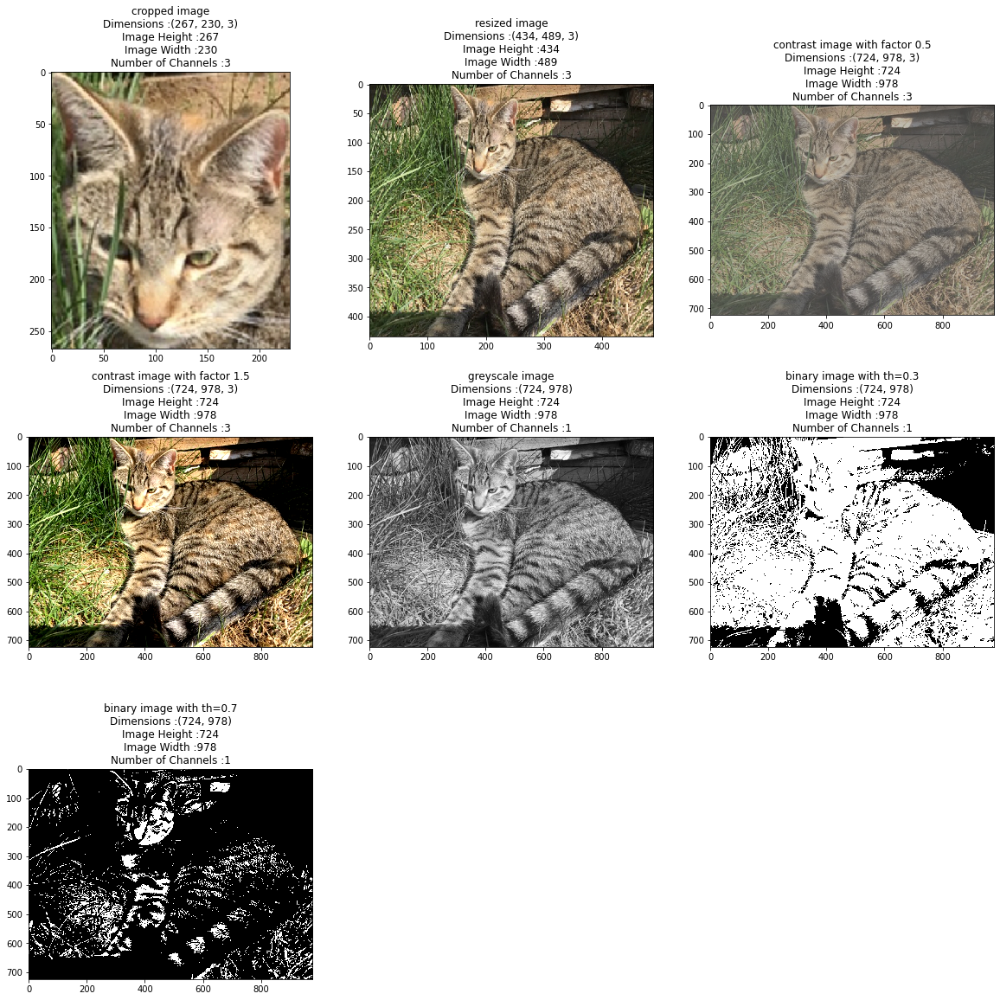

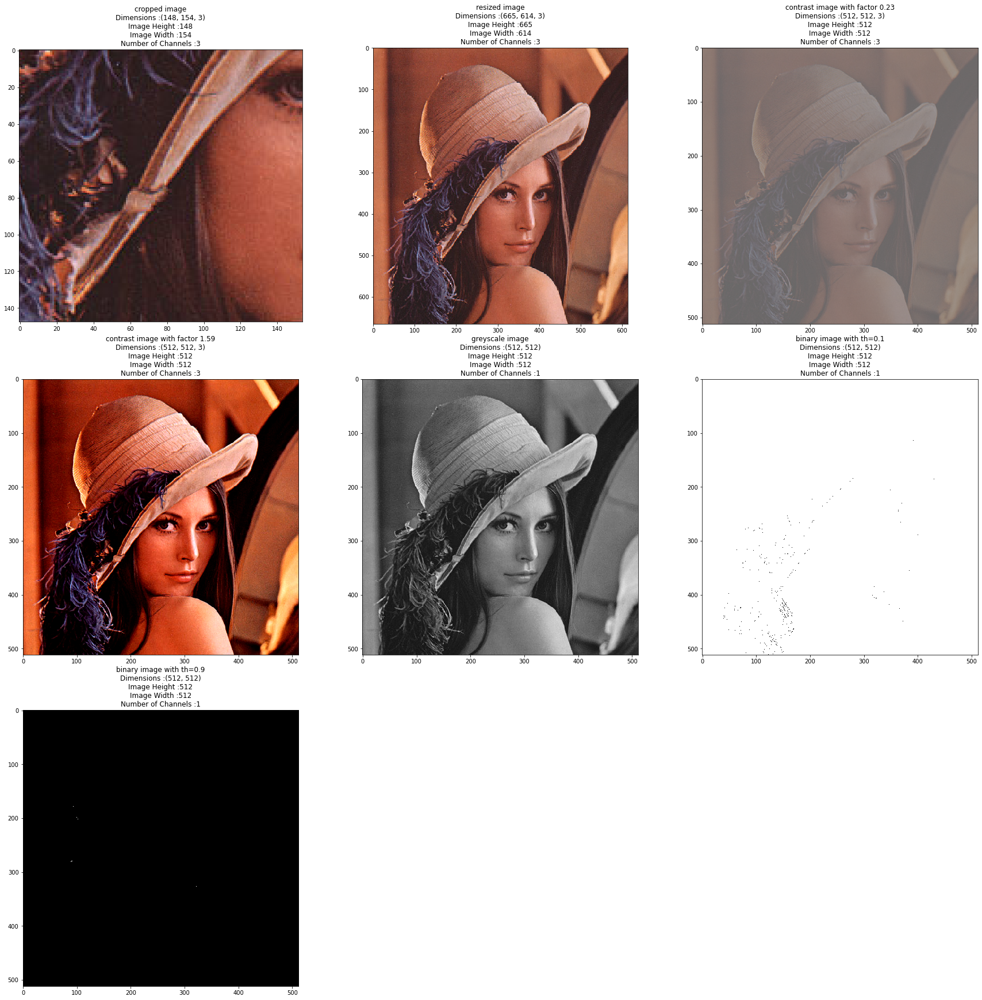

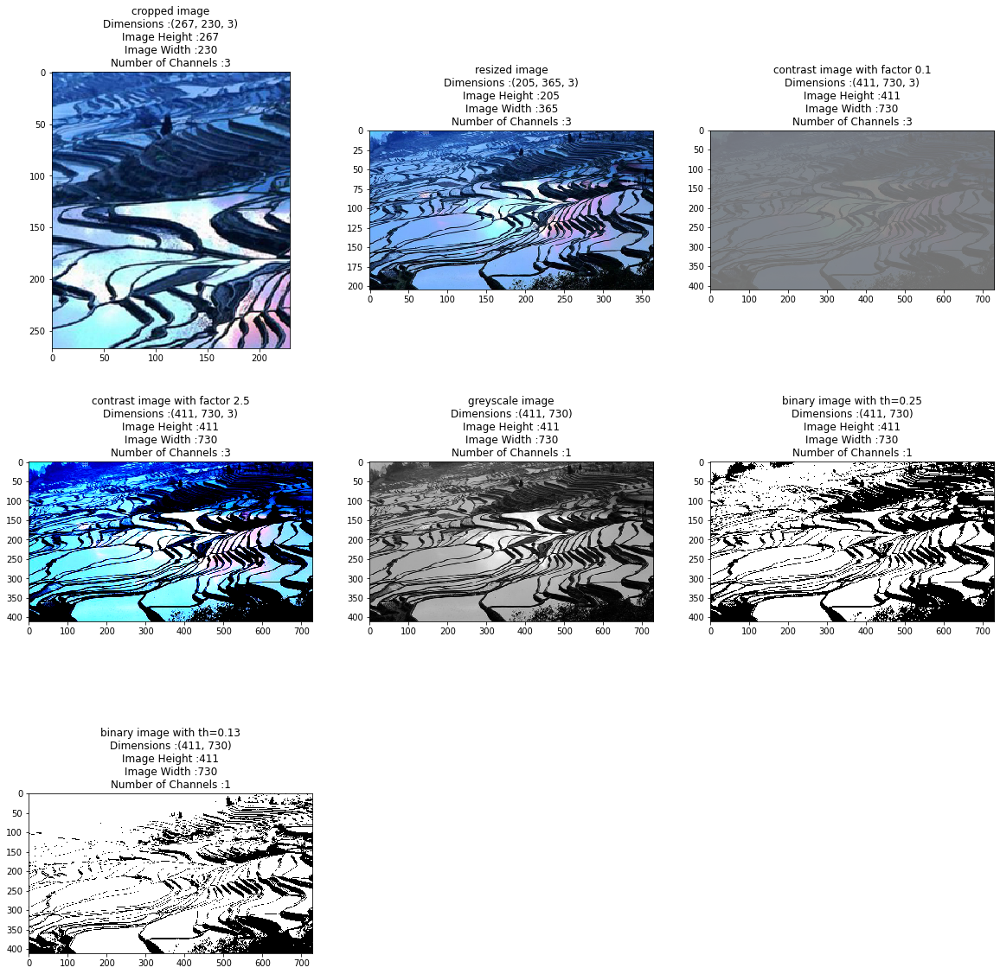

In [17]:
# This should crop the head from the cat image
image_group = []
crop_img = crop(image1, 278, 5, 508, 272)
image_group.append([crop_img, "cropped image"]) 

resize_cat = resize(image1, 0.5, 0.6 )
image_group.append([resize_cat, "resized image"]) 

contrast_img = change_contrast(image1, 0.5)
image_group.append([contrast_img, "contrast image with factor 0.5"]) 

contrast_img = change_contrast(image1, 1.5)
image_group.append([contrast_img, "contrast image with factor 1.5"]) 

grey_img = greyscale(image1)
image_group.append([grey_img, "greyscale image"]) 

binary_img = binary(grey_img, 0.3)
image_group.append([binary_img, "binary image with th=0.3"]) 

binary_img = binary(grey_img, 0.7)
image_group.append([binary_img, "binary image with th=0.7"]) 

display_all(image_group, 20, 3, 3)

testImg_group_1 = []
crop_img_Lena = crop(test_image_1, 109, 251, 263, 399)
testImg_group_1.append([crop_img_Lena, "cropped image"]) 

resize_Lena = resize(test_image_1, 1.2, 1.3 )
testImg_group_1.append([resize_Lena, "resized image"]) 

contrast_img = change_contrast(test_image_1, 0.23)
testImg_group_1.append([contrast_img, "contrast image with factor 0.23"]) 

contrast_img = change_contrast(test_image_1, 1.59)
testImg_group_1.append([contrast_img, "contrast image with factor 1.59"]) 

grey_img = greyscale(test_image_1)
testImg_group_1.append([grey_img, "greyscale image"]) 

binary_img = binary(grey_img, 0.1)
testImg_group_1.append([binary_img, "binary image with th=0.1"]) 

binary_img = binary(grey_img, 0.9)
testImg_group_1.append([binary_img, "binary image with th=0.9"])
display_all(testImg_group_1, 30, 3, 3 )

testImg_group_2 = []

crop_img_YunYang = crop(test_image_2, 278, 5, 508, 272)
testImg_group_2.append([crop_img_YunYang, "cropped image"]) 

resize_YunYang = resize(test_image_2, 0.5, 0.5 )
testImg_group_2.append([resize_YunYang, "resized image"]) 

contrast_img = change_contrast(test_image_2, 0.1)
testImg_group_2.append([contrast_img, "contrast image with factor 0.1"]) 

contrast_img = change_contrast(test_image_2, 2.5)
testImg_group_2.append([contrast_img, "contrast image with factor 2.5"]) 

grey_img = greyscale(test_image_2)
testImg_group_2.append([grey_img, "greyscale image"]) 

binary_img = binary(grey_img, 0.25)
testImg_group_2.append([binary_img, "binary image with th=0.25"]) 

binary_img = binary(grey_img, 0.13)
testImg_group_2.append([binary_img, "binary image with th=0.13"])
display_all(testImg_group_2, 20, 3, 3)

As we may see in the examples above, a binary image is produced based on setting a threshold value on the pixel intensity of the original image. Pixels below that set threshold value are converted to black (bit value of zero), and pixels above the threshold value are converted to white (a bit value of one). Since we have divided each pixel value by 255, the value range for each pixel will be between 0 and 1, which mean is if the threshold was set to be larger than 1, then all the pixels in the new image will be 0, hence an image with all dark pixels will be created, and vice versers. As you may see the cat's and Yuanyang Rice Terraces' example, by setting the different threshold values, the edges and outlines of the image will differ. Therefore, thresholding is particularly useful to convert a gray image into a binary image so that objects of interest are separated from the background. For thresholding to be effective, it is necessary that the object and background have sufficient contrast and that we know the intensity levels of either the objects or the background.

## Question 3: Convolution (20%)

### 3.1 2D convolution

Using the definition of 2D convolution from week 1, implement the convolution operation in the function `conv2D()` in a1code.py.


In [31]:
test_conv2D()

### 3.2 RGB convolution

In the function `conv` in a1code.py, extend your function `conv2D` to work on RGB images, by applying the 2D convolution to each channel independently. 

### 3.3 Gaussian filter convolution

Use the `gauss2D` function provided in a1code.py to create a Gaussian kernel, and apply it to your images with convolution. You will obtain marks for trying different tests and analysing the results, for example:

- try varying the image size, and the size and variance of the filter  
- subtract the filtered image from the original - this gives you an idea of what information is lost when filtering

What do you observe and why?

### 3.4 Sobel filters

Define a horizontal and vertical Sobel edge filter kernel and test them on your images. You will obtain marks for testing them and displaying results in interesting ways, for example:

- apply them to an image at different scales
- considering how to display positive and negative gradients
- apply different combinations of horizontal and vertical filters

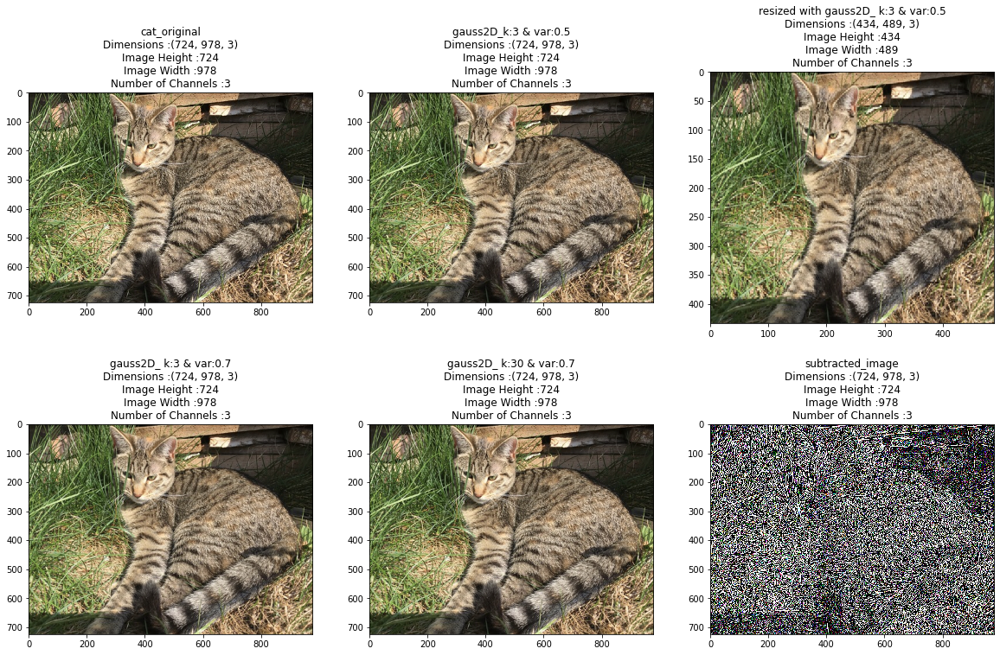

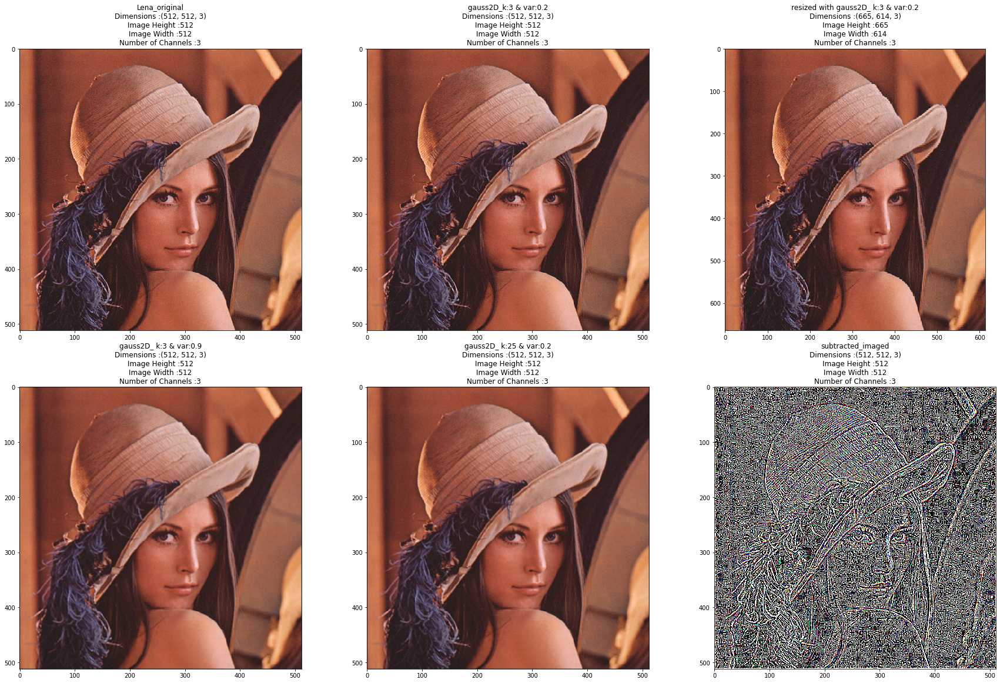

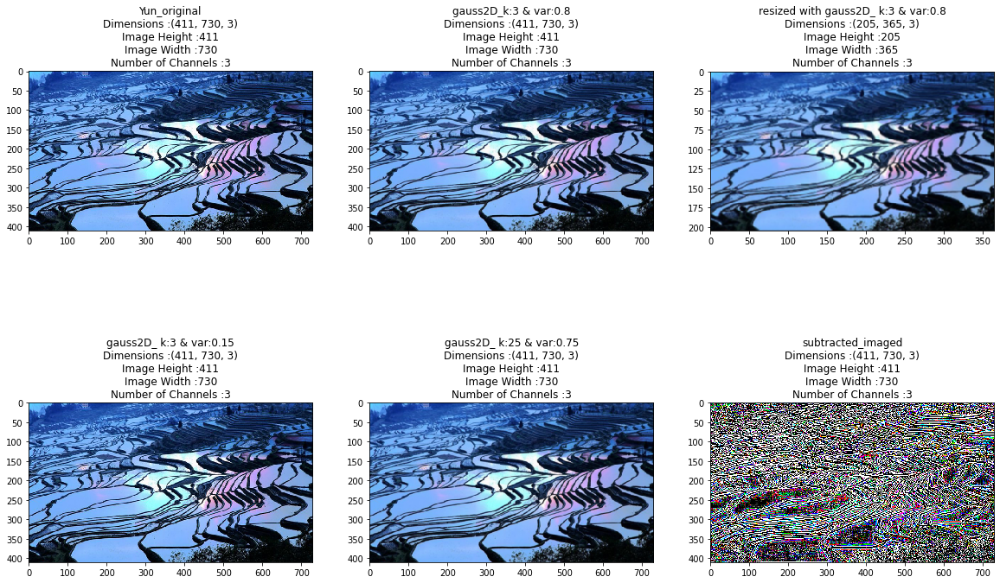

In [55]:
# Your code to answer 3.3, 3.4 and displaay results here.

#3.3
conv_cat = []
conv_cat.append([image1, "cat_original"])
conv_ori_cat = conv(image1, gauss2D(3, 0.5))
conv_cat.append([conv_ori_cat, "gauss2D_k:3 & var:0.5"])
conv_size_cat = conv(resize_cat, gauss2D(3, 0.5))
conv_cat.append([conv_size_cat, "resized with gauss2D_ k:3 & var:0.5"])
conv_vari_cat = conv(image1, gauss2D(3, 0.7))
conv_cat.append([conv_vari_cat, "gauss2D_ k:3 & var:0.7"])
conv_kernel_cat = conv(image1, gauss2D(30, 0.5))
conv_cat.append([conv_kernel_cat, "gauss2D_ k:30 & var:0.7"])

kernel_lost_cat = image1*255 - conv_kernel_cat*255
kernel_lost_cat = np.clip(kernel_lost_cat, 0, 1)
conv_cat.append([kernel_lost_cat, "subtracted_image"])
display_all(conv_cat, 20, 3, 3)

conv_Lena = []
conv_Lena.append([test_image_1, "Lena_original"])
conv_ori_Lena = conv(test_image_1, gauss2D(3, 0.2))
conv_Lena.append([conv_ori_Lena, "gauss2D_k:3 & var:0.2"])
conv_size_Lena = conv(resize_Lena, gauss2D(3, 0.2))
conv_Lena.append([conv_size_Lena, "resized with gauss2D_ k:3 & var:0.2"])
conv_vari_Lena = conv(test_image_1, gauss2D(3, 0.9))
conv_Lena.append([conv_vari_Lena, "gauss2D_ k:3 & var:0.9"])
conv_size_vari_Lena = conv(test_image_1, gauss2D(25, 0.7))
conv_Lena.append([conv_size_vari_Lena, "gauss2D_ k:25 & var:0.2"])

kernel_lost_Lena = test_image_1*255 - conv_size_vari_Lena*255
kernel_lost_Lena = np.clip(kernel_lost_Lena, 0, 1)
conv_Lena.append([kernel_lost_Lena, "subtracted_imaged"])
display_all(conv_Lena, 30, 3, 3)

conv_Yun = []
conv_Yun.append([test_image_2, "Yun_original"])
conv_ori_Yun = conv(test_image_2, gauss2D(3, 0.8))
conv_Yun.append([conv_ori_Yun, "gauss2D_k:3 & var:0.8"])
conv_size_Yun = conv(resize_YunYang, gauss2D(3, 0.8))
conv_Yun.append([conv_size_Yun, "resized with gauss2D_ k:3 & var:0.8"])
conv_vari_Yun = conv(test_image_2, gauss2D(3, 0.15))
conv_Yun.append([conv_vari_Yun, "gauss2D_ k:3 & var:0.15"])
conv_size_vari_Yun = conv(test_image_2, gauss2D(35, 0.75))
conv_Yun.append([conv_size_vari_Yun, "gauss2D_ k:25 & var:0.75"])

kernel_lost_Yun = test_image_2*255 - conv_size_vari_Yun*255
kernel_lost_Yun = np.clip(kernel_lost_Yun, 0, 1)
conv_Yun.append([kernel_lost_Yun, "subtracted_imaged"])
display_all(conv_Yun, 20, 3, 3)


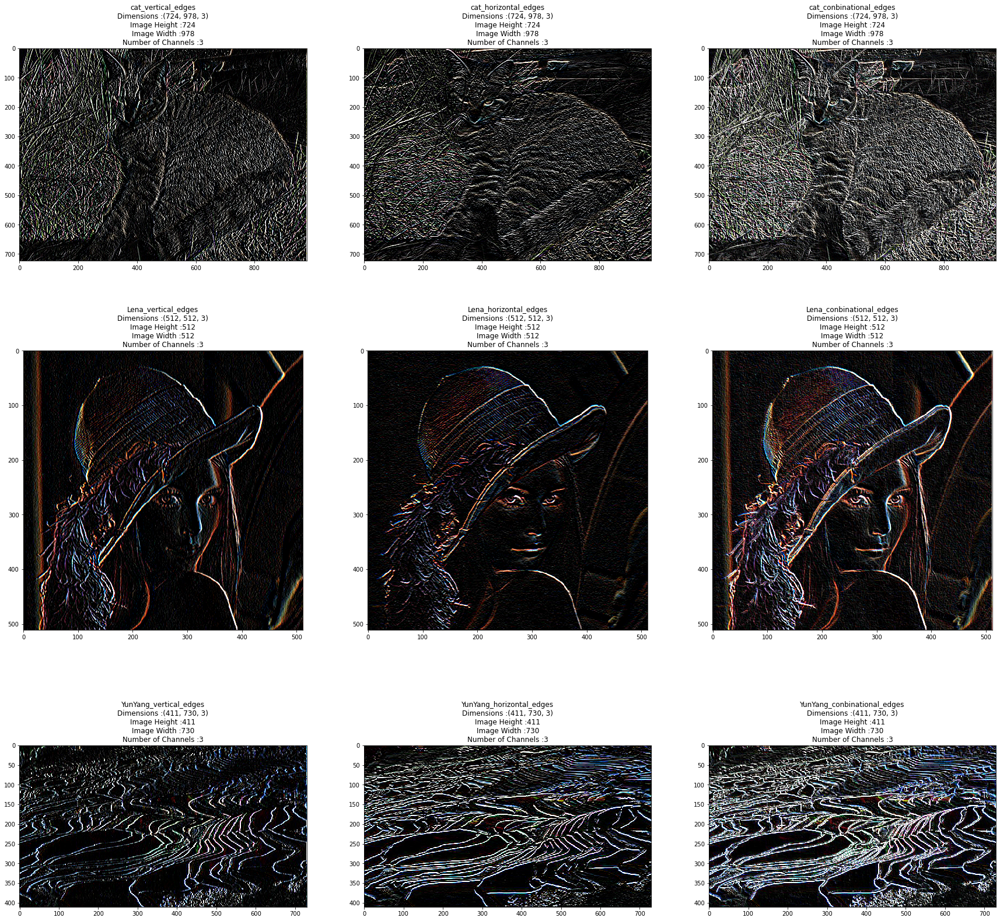

In [29]:
#3.4
filter_vertical = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])
filter_horizontal = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]])
sobel_cat = []

sobel_v_cat = conv(image1, filter_vertical)
sobel_v_cat = np.clip(sobel_v_cat, 0, 1)
sobel_cat.append([sobel_v_cat, "cat_vertical_edges"])
sobel_h_cat = conv(image1, filter_horizontal)
sobel_h_cat = np.clip(sobel_h_cat, 0, 1)
sobel_cat.append([sobel_h_cat, "cat_horizontal_edges"])
conb_cat = sobel_v_cat + sobel_h_cat
conb_cat = np.clip(conb_cat, 0, 1)
sobel_cat.append([conb_cat, "cat_conbinational_edges"])

sobel_v_Lena = conv(test_image_1, filter_vertical)
sobel_v_Lena = np.clip(sobel_v_Lena, 0, 1)
sobel_cat.append([sobel_v_Lena, "Lena_vertical_edges"])
sobel_h_Lena = conv(test_image_1, filter_horizontal)
sobel_h_Lena = np.clip(sobel_h_Lena, 0, 1)
sobel_cat.append([sobel_h_Lena, "Lena_horizontal_edges"])
conb_Lena = sobel_v_Lena + sobel_h_Lena
conb_Lena = np.clip(conb_Lena, 0, 1)
sobel_cat.append([conb_Lena, "Lena_conbinational_edges"])

sobel_v_Yun = conv(test_image_2, filter_vertical)
sobel_v_Yun = np.clip(sobel_v_Yun, 0, 1)
sobel_cat.append([sobel_v_Yun, "YunYang_vertical_edges"])
sobel_h_Yun = conv(test_image_2, filter_horizontal)
sobel_h_Yun = np.clip(sobel_h_Yun, 0, 1)
sobel_cat.append([sobel_h_Yun, "YunYang_horizontal_edges"])
conb_Yun = sobel_v_Yun + sobel_h_Yun
conb_Yun = np.clip(conb_Yun, 0, 1)
sobel_cat.append([conb_Yun, "YunYang_conbinational_edges"])

display_all(sobel_cat, 30, 3, 3)

***Your comments/analysis of your results here...***

3.3 Gaussian filter convolution:
One nice effect of Gaussian filter convolution is that it can blur the image. When we blur an image, we make the color transition from one side of an edge in the image to another smooth rather than sudden. The effect is to average out rapid changes in pixel intensity. In a Gaussian blur, the pixels nearest the center of the kernel are given more weight than those far away from the center. This averaging is done on a channel-by-channel basis, and the average channel values become the new value for the pixel in the filtered image. By changing the size of the image as well as the size of the Gaussian kernel and variant, we can observe that a larger kernel will blur the image more than a smaller kernel since a larger kernel has more values factored into the average. However, this also implies that a larger kernel will have more undesirable artifacts as well. As you may see in the examples above, the edges of the cat and Lena were blurred out more by using a larger kernel. Moreover, The role of sigma in the Gaussian filter is to control the variation around its mean value. So as the Sigma becomes larger the more variance allowed around mean and as the Sigma becomes smaller the less variance allowed around mean.

3.4 Sobel filters:
The Sobel filter is particularly useful for edge detection. The process of edge detection significantly reduces the amount of data and filters out unneeded information, while preserving the important structural properties of an image. Sobel filter works by calculating the gradient of image intensity at each pixel
within the image. It finds the direction of the largest increase from
light to dark and the rate of change in that direction.
The result shows how abruptly or smoothly the image changes at each
pixel, and therefore how likely it is that that pixel represents an edge.

Two ways to deal with positive and negative gradients:
• map the gradient of zero onto a half-tone grey level.
– This makes negative gradients appear darker, and positive gradients appear
brighter.
• Use the absolute values of the gradient map (stretched between 0
and 255).
• This makes very negative and very positive gradients appear brighter.

By combining the horizontal and vertical filters together, we actually get the full edges of the image.

## Question 4: Image sampling and pyramids (25%)

### 4.1 Image Sampling

Apply your `resize()` function to reduce an image (I) to 0.125 height and width, and then to enlarge the image back to its original size to get an image (I'). Display and compare I and I'.

Apply a Sobel filter to I to get the edge image E.

Apply a Sobel filter to I' to get the edge image E'.

Display and compare E and E'. What do you observe and why?

### 4.2 Image Pyramids 
Creat a Gaussian pyramid as described in week2's lecture on an image.

Apply a Gaussian kernel to an image I, and resize it with ratio 0.5, to get $I_1$. Repeat this step to get $I_2$, $I_3$ and $I_4$.

Display these four images following the zebra example shown in the lecture note.

What is your observation?



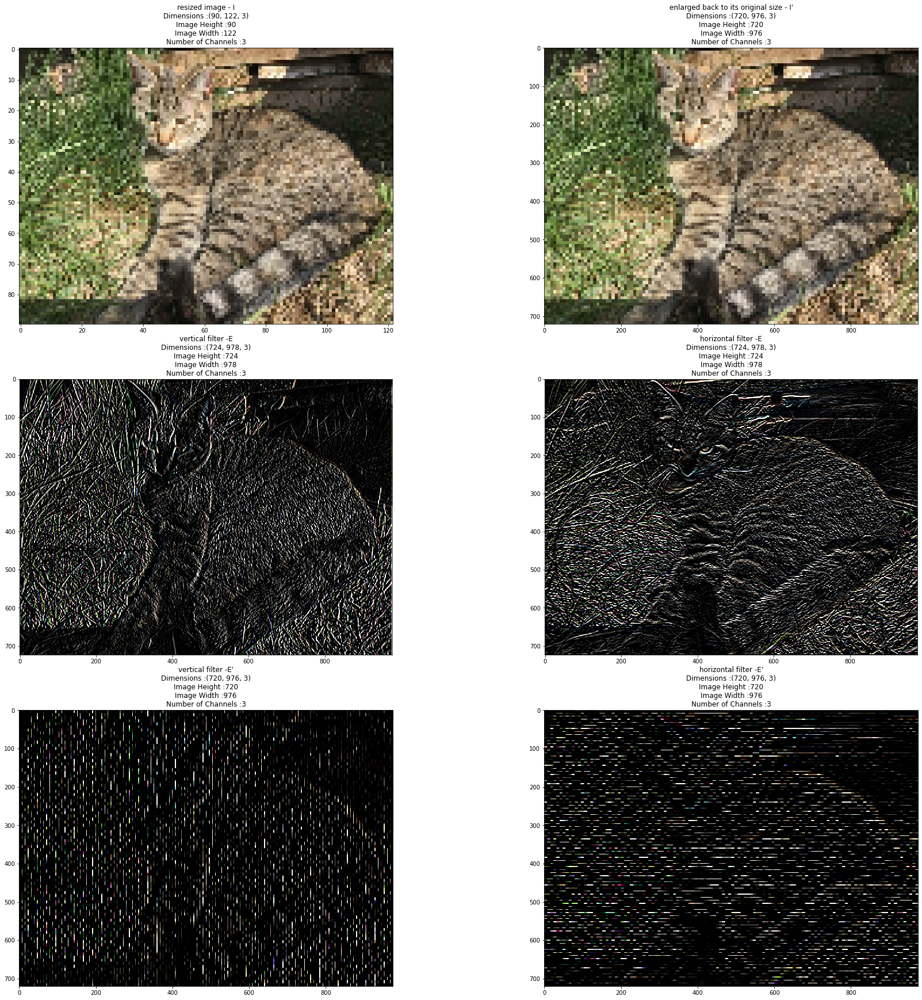

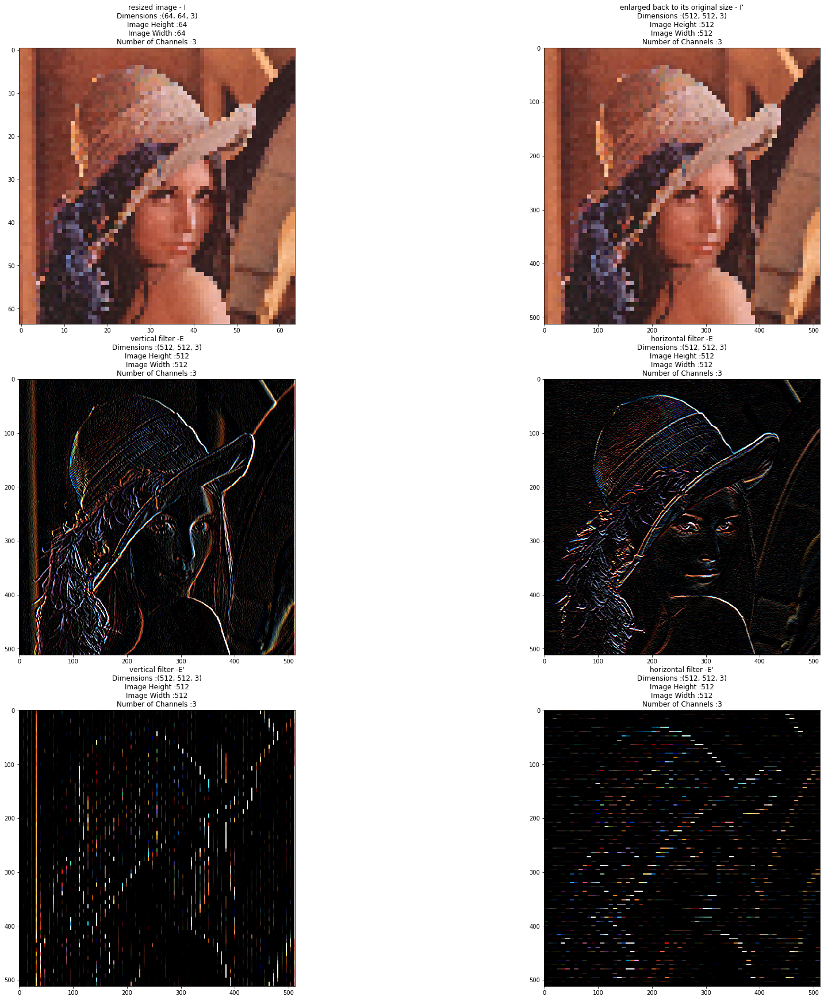

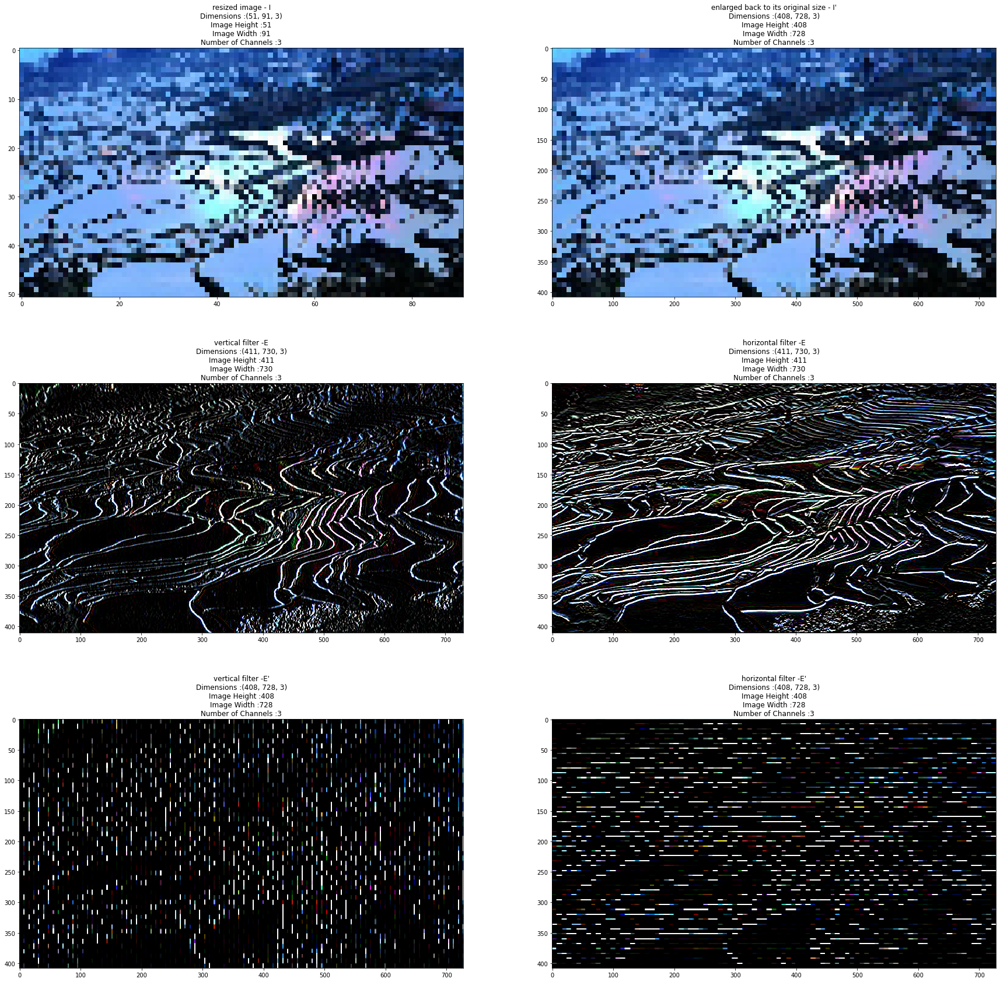

In [30]:
# Your answers to question 4 here
sam_cat = []
resize_image_cat = resize(image1, 0.125, 0.125 )
sam_cat.append([resize_image_cat, "resized image - I"])
ori_image = resize(resize_image_cat, 8, 8 )
sam_cat.append([ori_image, "enlarged back to its original size - I'"])

sam_cat.append([sobel_v_cat, "vertical filter -E"])
sam_cat.append([sobel_h_cat, "horizontal filter -E"])
cat_sample_v = conv(ori_image, filter_vertical)
cat_sample_v = np.clip(cat_sample_v, 0, 1)
sam_cat.append([cat_sample_v, "vertical filter -E'"])
cat_sample_h = conv(ori_image, filter_horizontal)
cat_sample_h = np.clip(cat_sample_h, 0, 1)
sam_cat.append([cat_sample_h, "horizontal filter -E'"])
display_all(sam_cat, 30, 3, 2)

sam_Lena = []
resize_image_Lena = resize(test_image_1, 0.125, 0.125 )
sam_Lena.append([resize_image_Lena, "resized image - I"])
ori_image_Lena = resize(resize_image_Lena, 8, 8 )
sam_Lena.append([ori_image_Lena, "enlarged back to its original size - I'"])

sam_Lena.append([sobel_v_Lena, "vertical filter -E"])
sam_Lena.append([sobel_h_Lena, "horizontal filter -E"])
Lena_sample_v = conv(ori_image_Lena, filter_vertical)
Lena_sample_v = np.clip(Lena_sample_v, 0, 1)
sam_Lena.append([Lena_sample_v, "vertical filter -E'"])
Lena_sample_h = conv(ori_image_Lena, filter_horizontal)
Lena_sample_h = np.clip(Lena_sample_h, 0, 1)
sam_Lena.append([Lena_sample_h, "horizontal filter -E'"])
display_all(sam_Lena, 30, 3, 2)

sam_Yun = []
resize_image_Yun = resize(test_image_2, 0.125, 0.125 )
sam_Yun.append([resize_image_Yun, "resized image - I"])
ori_image_Yun = resize(resize_image_Yun, 8, 8 )
sam_Yun.append([ori_image_Yun, "enlarged back to its original size - I'"])

sam_Yun.append([sobel_v_Yun, "vertical filter -E"])
sam_Yun.append([sobel_h_Yun, "horizontal filter -E"])
Yun_sample_v = conv(ori_image_Yun, filter_vertical)
Yun_sample_v = np.clip(Yun_sample_v, 0, 1)
sam_Yun.append([Yun_sample_v, "vertical filter -E'"])
Yun_sample_h = conv(ori_image_Yun, filter_horizontal)
Yun_sample_h = np.clip(Yun_sample_h, 0, 1)
sam_Yun.append([Yun_sample_h, "horizontal filter -E'"])
display_all(sam_Yun, 30, 3, 2)

In [77]:
def pyramid_display(image, kernel, caption):
  pyr_image = image
  r, c = pyr_image.shape[:2]
  background = np.zeros((r, c + c // 2, 3), dtype = np.double)
  z = 0
  background[:r,:c] = image
  for i in range(4):
    var1 = conv(pyr_image,kernel)
    var2 = resize(var1, 0.5, 0.5)
    r_new, c_new = var2.shape[:2]
    background[z:z+r_new, c:c+c_new] = var2
    pyr_image = var2
    z+=r_new
  plt.figure()
  plt.imshow(background)
  plt.title(caption)
  plt.axis('on')
  plt.show()


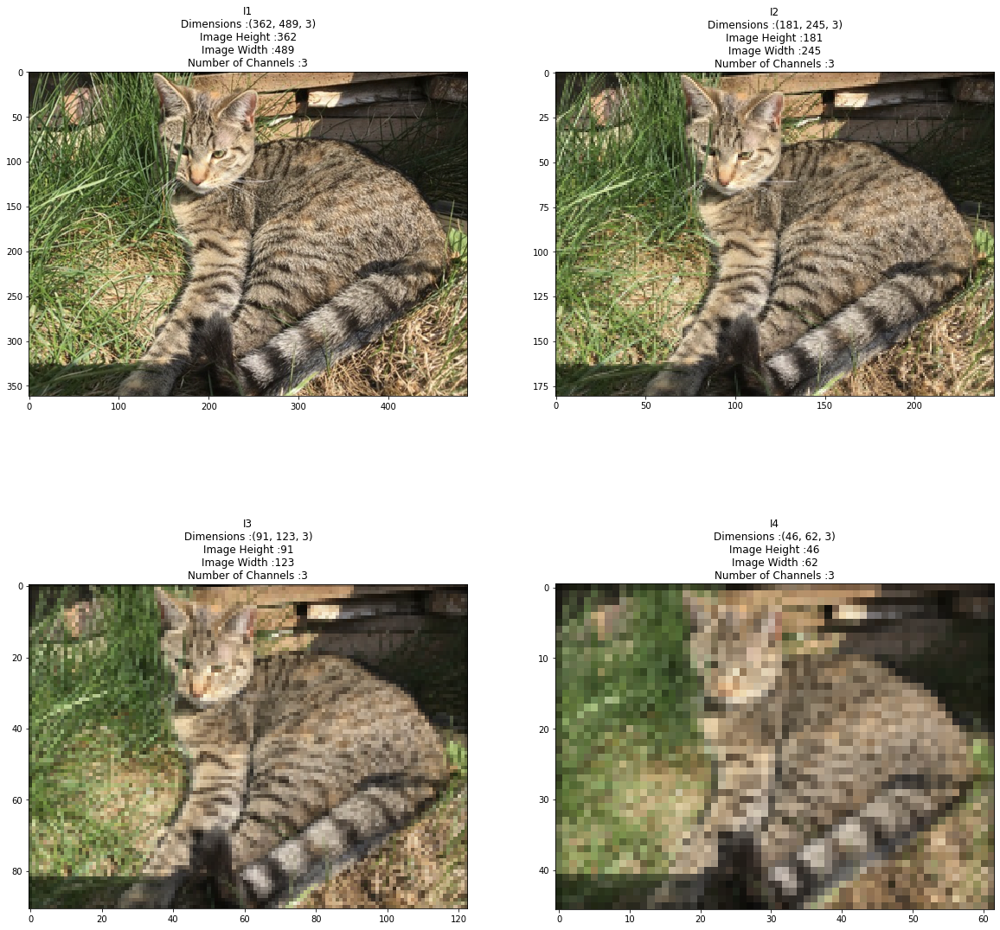

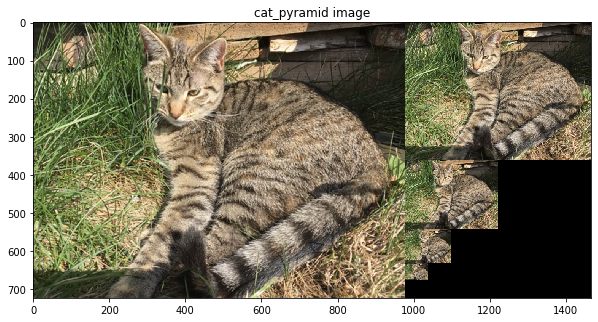

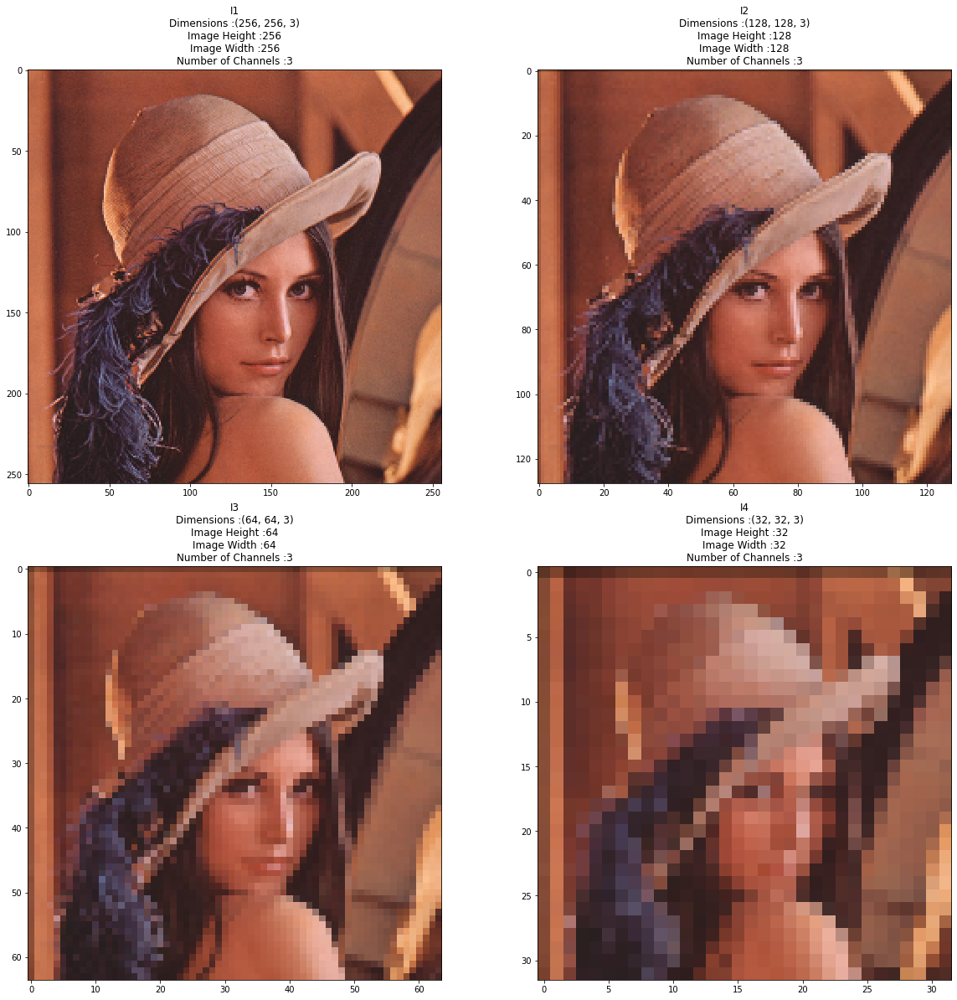

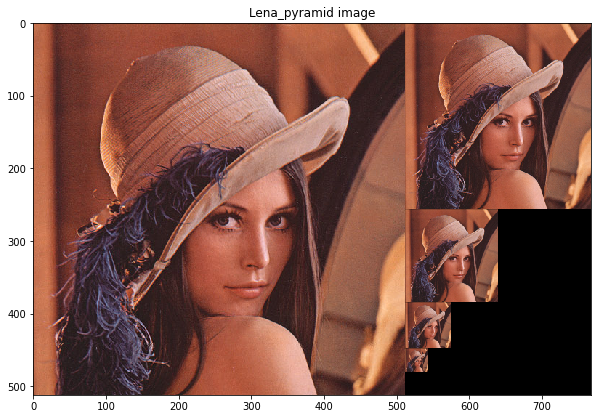

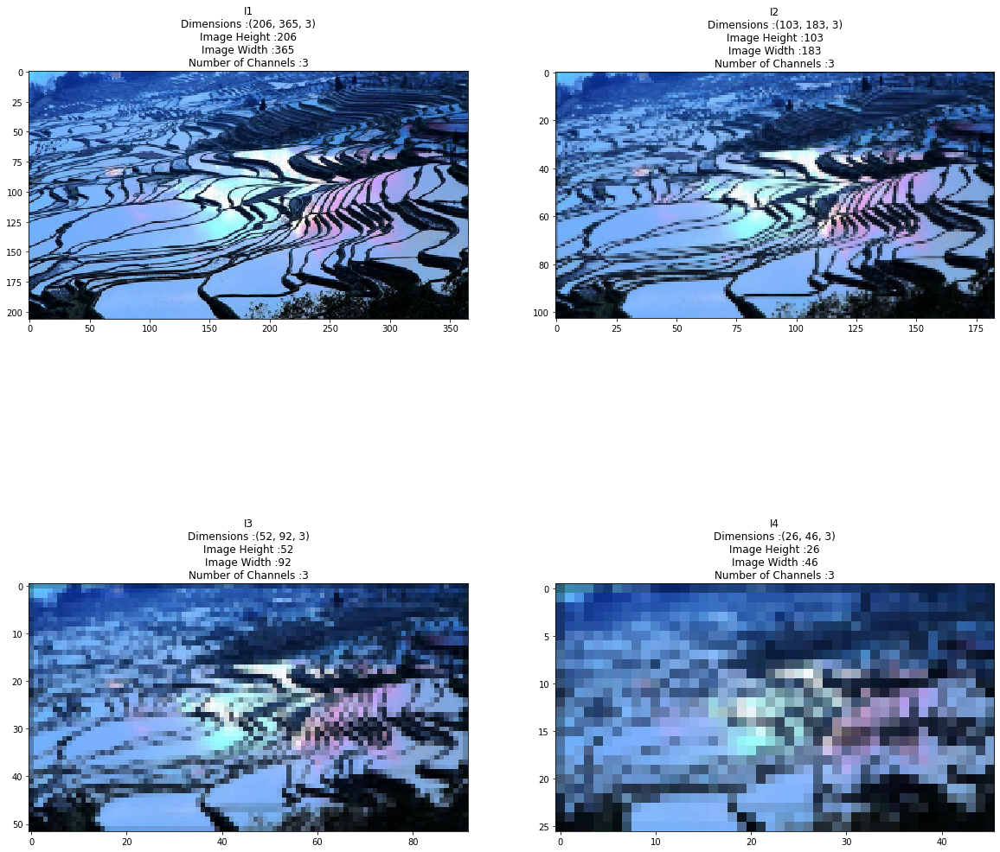

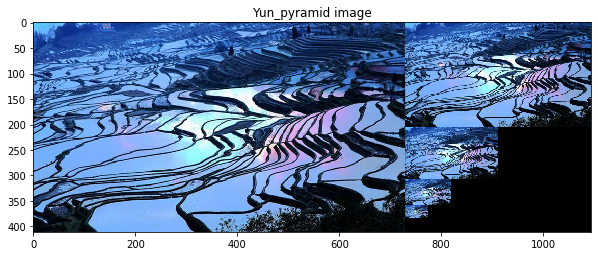

In [79]:
# 4.2:
layer1 = []
input_img = image1
for i in range(4):
  new_image = conv(input_img, gauss2D(3, 0.5))
  gp = new_image[::2, ::2]
  layer1.append([gp, "I" + str(i+1)])
  input_img = gp

display_all(layer1, 20, 2, 2)

pyramid_display(image1, gauss2D(3, 0.5), "cat_pyramid image")


layer2 = []
input_img_2 = test_image_1
for i in range(4):
  new_image = conv(input_img_2, gauss2D(3, 0.5))
  gp = new_image[::2, ::2]
  layer2.append([gp, "I" + str(i+1)])
  input_img_2 = gp

display_all(layer2, 20, 2, 2)
pyramid_display(test_image_1, gauss2D(3, 0.5), "Lena_pyramid image")

layer3 = []
input_img_3 = test_image_2
for i in range(4):
  new_image = conv(input_img_3, gauss2D(3, 0.5))
  gp = new_image[::2, ::2]
  layer3.append([gp, "I" + str(i+1)])
  input_img_3 = gp

display_all(layer3, 20, 2, 2)
pyramid_display(test_image_2, gauss2D(3, 0.5), "Yun_pyramid image")

***Your comments/analysis of your results here...***

4.1 Image Sampling:
As we may see from the above examples, the image has already lost some resolutions and information through the resize function, and even though we tried to enlarge the image back to its original size, the information has been lost, which means to reconstruct to the original image is impossible. The edge images before and after sampling can be also viewed as evidence that the image cannot be reconstructed due to the information lost in the sampling process.

4.2 Image Pyramids:
Sometimes to detect an object in an image, we need to resize or sub-sample the image and run further analysis. In such cases, we maintain a collection of the same image with different resolutions and that's how Image Pyramids are useful. As we may see in the above examples, the size of the image, as well as the resolution, is halved each time. The logic behind this is: each pyramid layer is constructed by applying the low-pass filter to the upper part and then reducing its size by the factor of 0.5. This process is called “Reduce operation“.  Because each layer of this pyramid is a low-pass filtered image with a different filter range, this pyramid is called the “Gaussian Pyramid”

## Question 5: Auto correlation (20%)

Recall from week 2 that cross-correlation is a measure of similarity between a template and an image. It is defined similarly to convolution.

### 5.1 Correlation function

Implement the function `corr()` in a1code.py, based on your convolution function. Hint: numpy's `flip()` function may be useful here.

### 5.2 Auto-correlation

We will experiment with *auto-correlation*, where the template patch is taken from the image it is being compared to. Use the cropped eye from Question 2 as your template. Calculate the correlation of that template with every location in the image, and display the output as an image. Where is the maximum similarity? (Hint: numpy functions `argmax()` and `unravel()` will be useful here). For simplicity, you can use a greyscale version of the image and template.

Is it what you expect? Why or why not?

### 5.3 Modified auto-correlation

Try modifying your correlation template or the base image in different ways, and analyse the effect on correlation results. For example:

- if you did not find the correct location in 5.2, try centering the template about its mean (i.e. subtracting the mean brightness from each pixel)
- if you did find the correct location in 5.2, try using `resize()` and `change_contrast()` on the image. Where does it fail?

As before you will obtain marks for coming up with interesting tests and analysis, and displaying your results clearly. 


In [26]:
from matplotlib.patches import Rectangle
def display_corr_all(image_group, size, r, c):
    # Show image using pyplot 
    fig = plt.figure(figsize=(size, size))
    rows = r
    columns = c
    num = 1

    while image_group:
      image_node = image_group.pop(0)
      if len(image_node) == 2:
        image_content = image_node[0]
        image_caption = image_node[1]
        dimensions = str(image_content.shape)
        height = str(image_content.shape[0])
        width = str(image_content.shape[1])
        if image_content.ndim < 3:
          channels = "1"
        else:
          channels = str(image_content.shape[2])
        fig.add_subplot(rows, columns, num)
        plt.imshow(image_content)
        plt.title(image_caption + "\n" + "Dimensions :" + dimensions + "\n" + "Image Height :" + height + "\n" + "Image Width :" + width + "\n" + "Number of Channels :" + channels)
        plt.axis('on')
        num+=1
      else:
        image_content = image_node[0]
        temnplate_content = image_node[1]
        coordinate = image_node[2]
        image_caption = image_node[3]
        height = str(image_content.shape[0])
        width = str(image_content.shape[1])
        if image_content.ndim < 3:
          channels = "1"
        else:
          channels = str(image_content.shape[2])
        fig.add_subplot(rows, columns, num)
        template_height, template_width = temnplate_content.shape
        y, x = coordinate
        rect = plt.Rectangle((x-120, y-130), template_width, template_height, 
                          color='r', fc='none')
        plt.gca().add_patch(rect)
        plt.title(image_caption + "\n" + "Dimensions :" + dimensions + "\n" + "Image Height :" + height + "\n" + "Image Width :" + width + "\n" + "Number of Channels :" + channels + "\n" + "coordinate: " + str(coordinate))
        plt.axis('on')
        plt.imshow(image_content, cmap='viridis')
        num+=1


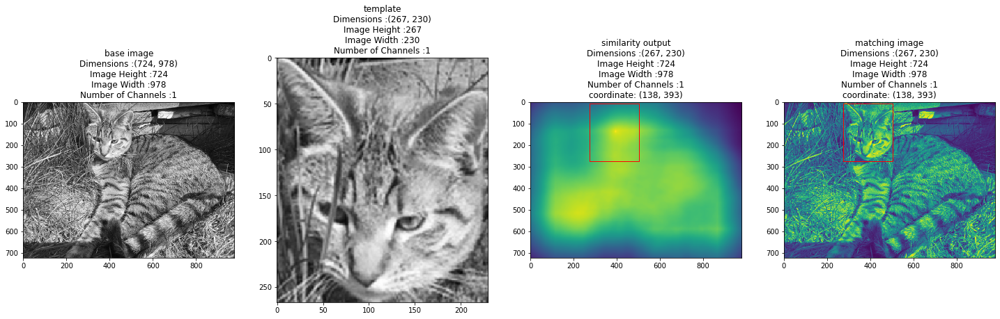

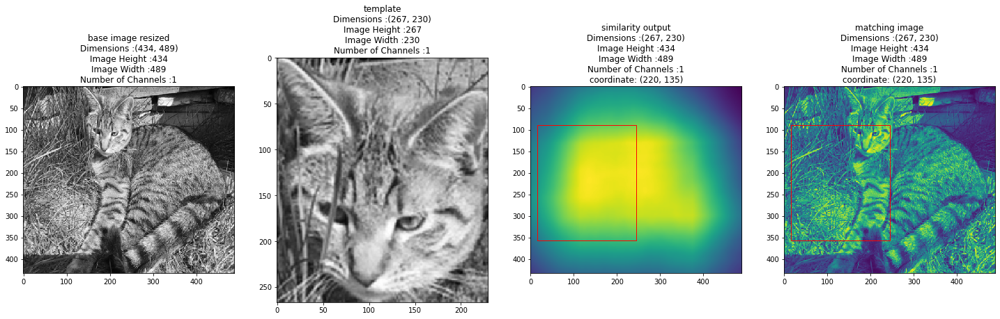

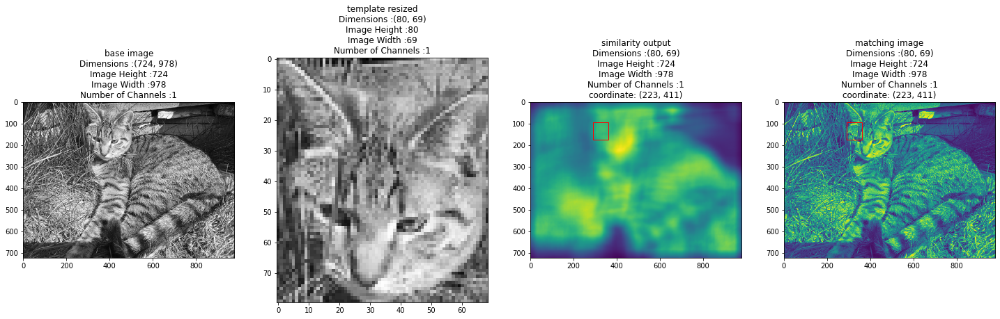

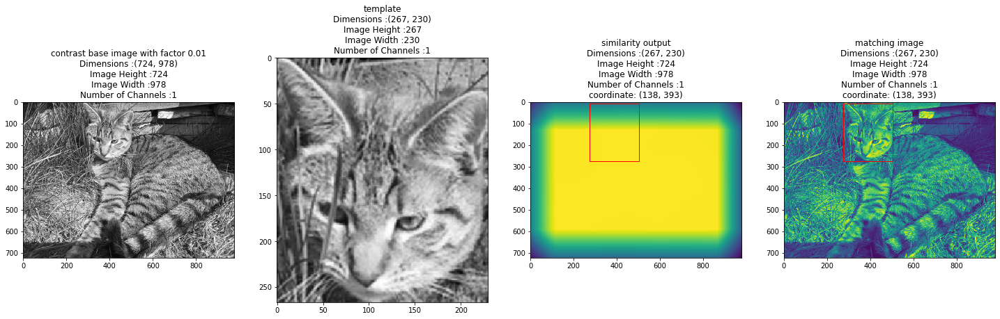

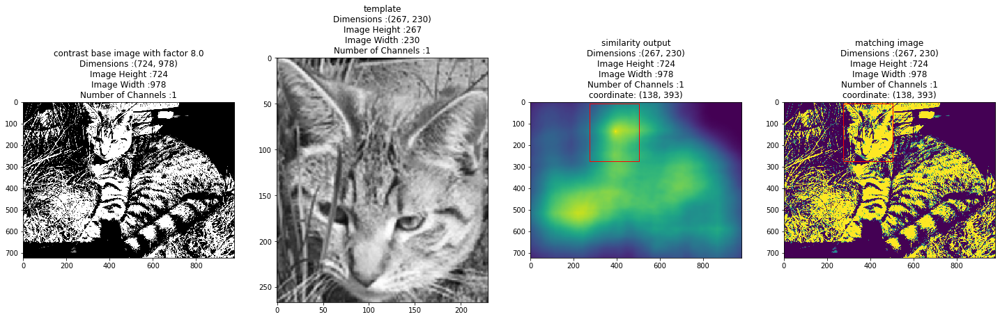

...

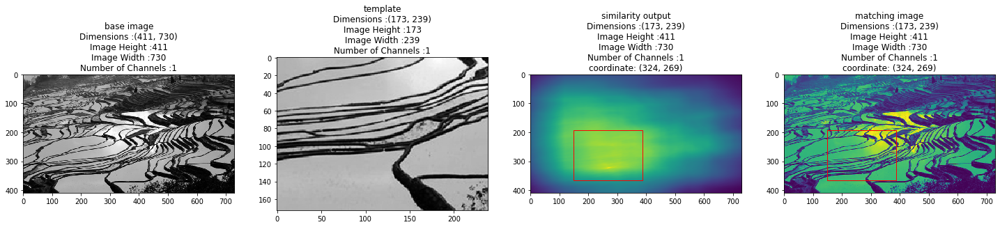

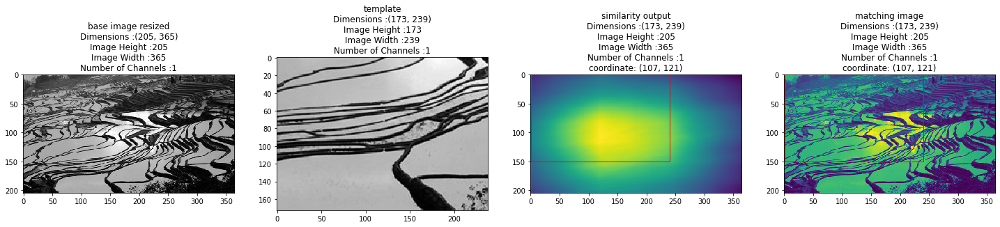

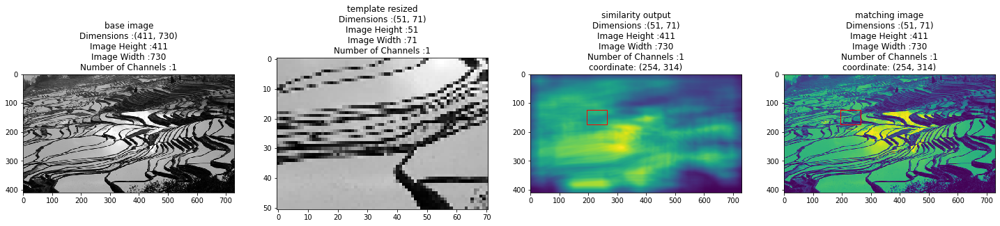

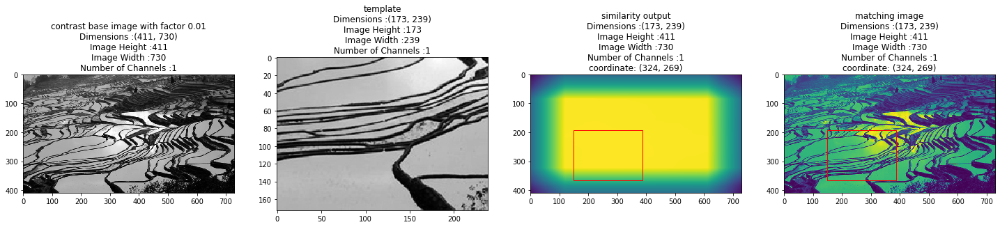

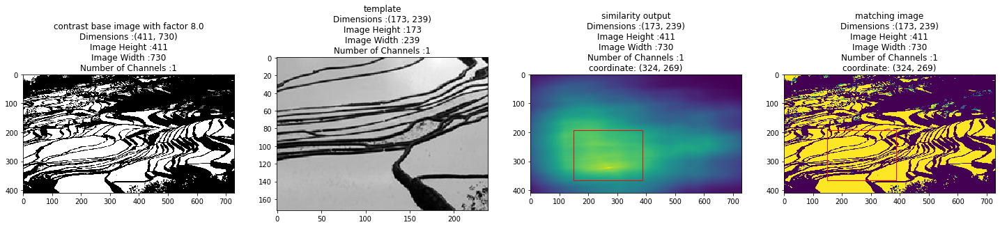

In [27]:
# Your code to answer question 5 and display results here

# cat_image

corr_list_cat = []
grey_cat = greyscale(image1)
corr_list_cat.append([grey_cat, "base image"])
template = greyscale(crop_img)
corr_list_cat.append([template, "template"])
corr_result_cat = corr(grey_cat, template)
coordination = np.unravel_index(np.argmax(corr_result_cat), corr_result_cat.shape)
corr_list_cat.append([corr_result_cat, template, coordination, "similarity output"])
corr_list_cat.append([grey_cat, template, coordination, "matching image"])
display_corr_all(corr_list_cat, 25, 1, 4)

corr_list_resize_1 = []
grey_cat_resized = greyscale(resize_cat)
corr_list_resize_1.append([grey_cat_resized, "base image resized"])
template = greyscale(crop_img)
corr_list_resize_1.append([template, "template"])
corr_result_cat = corr(grey_cat_resized, template)
coordination = np.unravel_index(np.argmax(corr_result_cat), corr_result_cat.shape)
corr_list_resize_1.append([corr_result_cat, template, coordination, "similarity output"])
corr_list_resize_1.append([grey_cat_resized, template, coordination, "matching image"])
display_corr_all(corr_list_resize_1, 25, 1, 4)

corr_list_resize_2 = []
grey_cat = greyscale(image1)
corr_list_resize_2.append([grey_cat, "base image"])
new_template = resize(crop_img, 0.3, 0.3)
new_template_grey = greyscale(new_template)
corr_list_resize_2.append([new_template_grey, "template resized"])
corr_result_cat = corr(grey_cat, new_template_grey)
coordination = np.unravel_index(np.argmax(corr_result_cat), corr_result_cat.shape)
corr_list_resize_2.append([corr_result_cat, new_template_grey, coordination, "similarity output"])
corr_list_resize_2.append([grey_cat, new_template_grey, coordination, "matching image"])
display_corr_all(corr_list_resize_2, 25, 1, 4)


corr_list_contrast_1 = []
grey_cat = greyscale(image1)
contrast_img_base = change_contrast(grey_cat, 0.01)
corr_list_contrast_1.append([contrast_img_base, "contrast base image with factor 0.01"])
template = greyscale(crop_img)
corr_list_contrast_1.append([template, "template"])
corr_result_cat = corr(contrast_img_base, template)
coordination = np.unravel_index(np.argmax(corr_result_cat), corr_result_cat.shape)
corr_list_contrast_1.append([corr_result_cat, template, coordination, "similarity output"])
corr_list_contrast_1.append([contrast_img_base, template, coordination, "matching image"])
display_corr_all(corr_list_contrast_1, 25, 1, 4)


corr_list_contrast_2 = []
grey_cat = greyscale(image1)
contrast_img_base_2 = change_contrast(grey_cat, 8.0)
corr_list_contrast_2.append([contrast_img_base_2, "contrast base image with factor 8.0"]) 
template = greyscale(crop_img)
corr_list_contrast_2.append([template, "template"])
corr_result_cat = corr(contrast_img_base_2, template)
coordination = np.unravel_index(np.argmax(corr_result_cat), corr_result_cat.shape)
corr_list_contrast_2.append([corr_result_cat, template, coordination, "similarity output"])
corr_list_contrast_2.append([contrast_img_base_2, template, coordination, "matching image"])
display_corr_all(corr_list_contrast_2, 25, 1, 4)


# Lena_image:
corr_list_Lena = []
crop_img_Lena = crop(test_image_1, 200, 180, 469, 462)
grey_Lena = greyscale(test_image_1)
corr_list_Lena.append([grey_Lena, "base image"])
template = greyscale(crop_img_Lena)
corr_list_Lena.append([template, "template"])
corr_result_Lena = corr(grey_Lena, template)
coordination = np.unravel_index(np.argmax(corr_result_Lena), corr_result_Lena.shape)
corr_list_Lena.append([corr_result_Lena, template, coordination, "similarity output"])
corr_list_Lena.append([grey_Lena, template, coordination, "matching image"])
display_corr_all(corr_list_Lena, 25, 1, 4)

corr_list_resize_1_Lena = []
grey_Lena_resized = greyscale(resize_Lena)
corr_list_resize_1_Lena.append([grey_Lena_resized, "base image resized"])
template = greyscale(crop_img_Lena)
corr_list_resize_1_Lena.append([template, "template"])
corr_result_Lena = corr(grey_Lena_resized, template)
coordination = np.unravel_index(np.argmax(corr_result_Lena), corr_result_Lena.shape)
corr_list_resize_1_Lena.append([corr_result_Lena, template, coordination, "similarity output"])
corr_list_resize_1_Lena.append([grey_Lena_resized, template, coordination, "matching image"])
display_corr_all(corr_list_resize_1_Lena, 25, 1, 4)

corr_list_resize_2_Lena = []
corr_list_resize_2_Lena.append([grey_Lena, "base image"])
new_template = resize(crop_img_Lena, 0.3, 0.3)
new_template_grey = greyscale(new_template)
corr_list_resize_2_Lena.append([new_template_grey, "template resized"])
corr_result_Lena = corr(grey_Lena, new_template_grey)
coordination = np.unravel_index(np.argmax(corr_result_Lena), corr_result_Lena.shape)
corr_list_resize_2_Lena.append([corr_result_Lena, new_template_grey, coordination, "similarity output"])
corr_list_resize_2_Lena.append([grey_Lena, new_template_grey, coordination, "matching image"])
display_corr_all(corr_list_resize_2_Lena, 25, 1, 4)


corr_list_contrast_1_Lena = []
contrast_img_base = change_contrast(grey_Lena, 0.01)
corr_list_contrast_1_Lena.append([contrast_img_base, "contrast base image with factor 0.01"])
template = greyscale(crop_img_Lena)
corr_list_contrast_1_Lena.append([template, "template"])
corr_result_Lena = corr(contrast_img_base, template)
coordination = np.unravel_index(np.argmax(corr_result_Lena), corr_result_Lena.shape)
corr_list_contrast_1_Lena.append([corr_result_Lena, template, coordination, "similarity output"])
corr_list_contrast_1_Lena.append([contrast_img_base, template, coordination, "matching image"])
display_corr_all(corr_list_contrast_1_Lena, 25, 1, 4)


corr_list_contrast_2_Lena = []
contrast_img_base_2_Lena = change_contrast(grey_Lena, 8.0)
corr_list_contrast_2_Lena.append([contrast_img_base_2_Lena, "contrast base image with factor 8.0"]) 
template = greyscale(crop_img_Lena)
corr_list_contrast_2_Lena.append([template, "template"])
corr_result_Lena = corr(contrast_img_base_2_Lena, template)
coordination = np.unravel_index(np.argmax(corr_result_Lena), corr_result_Lena.shape)
corr_list_contrast_2_Lena.append([corr_result_Lena, template, coordination, "similarity output"])
corr_list_contrast_2_Lena.append([contrast_img_base_2_Lena, template, coordination, "matching image"])
display_corr_all(corr_list_contrast_2_Lena, 25, 1, 4)


# Yun image:
corr_list_Yun = []
crop_img_YunYang = crop(test_image_2, 150, 238, 389, 575)
grey_Yun = greyscale(test_image_2)
corr_list_Yun.append([grey_Yun, "base image"])
template = greyscale(crop_img_YunYang)
corr_list_Yun.append([template, "template"])
corr_result_Yun = corr(grey_Yun, template)
coordination = np.unravel_index(np.argmax(corr_result_Yun), corr_result_Yun.shape)
corr_list_Yun.append([corr_result_Yun, template, coordination, "similarity output"])
corr_list_Yun.append([grey_Yun, template, coordination, "matching image"])
display_corr_all(corr_list_Yun, 25, 1, 4)

corr_list_resize_1_Yun = []
grey_Yun_resized = greyscale(resize_YunYang)
corr_list_resize_1_Yun.append([grey_Yun_resized, "base image resized"])
template = greyscale(crop_img_YunYang)
corr_list_resize_1_Yun.append([template, "template"])
corr_result_Yun = corr(grey_Yun_resized, template)
coordination = np.unravel_index(np.argmax(corr_result_Yun), corr_result_Yun.shape)
corr_list_resize_1_Yun.append([corr_result_Yun, template, coordination, "similarity output"])
corr_list_resize_1_Yun.append([grey_Yun_resized, template, coordination, "matching image"])
display_corr_all(corr_list_resize_1_Yun, 25, 1, 4)

corr_list_resize_2_Yun = []
corr_list_resize_2_Yun.append([grey_Yun, "base image"])
new_template = resize(crop_img_YunYang, 0.3, 0.3)
new_template_grey = greyscale(new_template)
corr_list_resize_2_Yun.append([new_template_grey, "template resized"])
corr_result_Yun = corr(grey_Yun, new_template_grey)
coordination = np.unravel_index(np.argmax(corr_result_Yun), corr_result_Yun.shape)
corr_list_resize_2_Yun.append([corr_result_Yun, new_template_grey, coordination, "similarity output"])
corr_list_resize_2_Yun.append([grey_Yun, new_template_grey, coordination, "matching image"])
display_corr_all(corr_list_resize_2_Yun, 25, 1, 4)


corr_list_contrast_1_Yun = []
contrast_img_base = change_contrast(grey_Yun, 0.01)
corr_list_contrast_1_Yun.append([contrast_img_base, "contrast base image with factor 0.01"])
template = greyscale(crop_img_YunYang)
corr_list_contrast_1_Yun.append([template, "template"])
corr_result_Yun = corr(contrast_img_base, template)
coordination = np.unravel_index(np.argmax(corr_result_Yun), corr_result_Yun.shape)
corr_list_contrast_1_Yun.append([corr_result_Yun, template, coordination, "similarity output"])
corr_list_contrast_1_Yun.append([contrast_img_base, template, coordination, "matching image"])
display_corr_all(corr_list_contrast_1_Yun, 25, 1, 4)


corr_list_contrast_2_Yun = []
contrast_img_base_2_Yun = change_contrast(grey_Yun, 8.0)
corr_list_contrast_2_Yun.append([contrast_img_base_2_Yun, "contrast base image with factor 8.0"]) 
template = greyscale(crop_img_YunYang)
corr_list_contrast_2_Yun.append([template, "template"])
corr_result_Yun = corr(contrast_img_base_2_Yun, template)
coordination = np.unravel_index(np.argmax(corr_result_Yun), corr_result_Yun.shape)
corr_list_contrast_2_Yun.append([corr_result_Yun, template, coordination, "similarity output"])
corr_list_contrast_2_Yun.append([contrast_img_base_2_Yun, template, coordination, "matching image"])
display_corr_all(corr_list_contrast_2_Yun, 25, 1, 4)



 Cross-correlation is a technique for finding a reference image (or a template image) in the source image. In its most basic sense, the algorithm works by comparing the template for each part of the source image by sliding it one pixel at a time. This algorithm’s output is another image whose pixel value corresponds to the similarity of the template image to the source image when it was placed at that pixel location. For question 5, the source image would be the cat and the template image would be the head of the cat. As you can see in the output image after cross-correlation, the brighter the section of the image, the closer of a match it is to the template. Therefore, the highest similarity appeared at (138,393), which has verified that the cross-correlation worked well because the coordinate of the output is within the range of cat head. However, as we change the size and contrast of the source image as well as the template, the cross-correlation may fail in some cases. Therefore, there're some assumptions under which cross-correlation works: the size of the template should be no greater than the source image, and the contrast change for the source image and template should be within a suitable range. 